This file represents an attempt at Dynamic Range Compression

https://en.wikipedia.org/wiki/Dynamic_range_compression

In [2]:
import numpy as np
import scipy

In [5]:
def genSine(A, f, phi, fs, t):
    """
    Inputs:
        A (float) =  amplitude of the sinusoid
        f (float) = frequency of the sinusoid in Hz
        phi (float) = initial phase of the sinusoid in radians
        fs (float) = sampling frequency of the sinusoid in Hz
        t (float) =  duration of the sinusoid (is second)
    Output:
        The function should return a numpy array
        x (numpy array) = The generated sinusoid
    """
    ## Your code here

    return A * np.cos(2 * np.pi * f * np.arange(fs * t) / fs + phi)

In [6]:
from scipy.fftpack import fft

M = 250
epsilon = 1e-6

x1 = genSine(1, 80, 0, 10000, 1)
x2 = genSine(1, 200, 0, 10000, 1)
x = x1 + x2
X = fft(x[:M])
(abs(X) >= epsilon).nonzero()

(array([  2,   5, 245, 248]),)

In [8]:
# http://stackoverflow.com/questions/16241944/playing-a-sound-in-a-ipython-notebook
import IPython
# song from sound cloud
IPython.display.Audio("etude.mp3")


In [11]:
import IPython
# song from sound cloud
IPython.display.Audio("etude-short.wav")


In [5]:
# https://wiki.python.org/moin/Audio/
# https://wiki.python.org/moin/PythonInMusic

# http://stackoverflow.com/questions/13329617/change-the-volume-of-a-wav-file-in-python
import wave, numpy, struct

def read_wave(fn):
    # Open
    w = wave.open(fn,"rb")
    p = w.getparams()
    f = p[3] # number of frames
    s = w.readframes(f)
    w.close()
    return (numpy.fromstring(s, numpy.int16), p)

arr, params = read_wave("etude-short.wav")

In [17]:
# Save
def save_wave(arr, params, fn):
    out_s = struct.pack('h'*len(arr), *arr)
    w = wave.open(fn,"wb")
    w.setparams(params)
    w.writeframes(out_s)
    w.close()

save_wave(narr, params, "etude-modified.wav")
#xarr = read_wave("etude-modified.wav")

/home/ubuntu/miniconda2/lib/python2.7/site-packages/ipykernel/__main__.py:3: DeprecationWarning: integer argument expected, got float
  app.launch_new_instance()


In [18]:
import IPython
IPython.display.Audio("etude-modified.wav")


In [42]:
arr.size

1778398

In [7]:
numpy.max(arr)

32758

In [8]:
numpy.min(arr)

-32768

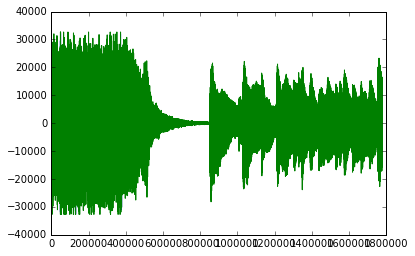

In [15]:
# http://stackoverflow.com/questions/19410042/how-to-make-ipython-notebook-matplotlib-plot-inline
%matplotlib inline

import matplotlib
import matplotlib.pyplot as plt
plt.plot(arr)
plt.plot(narr)
plt.show()


In [64]:
print numpy.max(numpy.abs(arr[:600000]))
print numpy.max(numpy.abs(arr[600000:700000]))
print numpy.max(numpy.abs(arr[900000:]))

print numpy.mean(numpy.abs(arr[:600000]))
print numpy.mean(numpy.abs(arr[600000:700000]))
print numpy.mean(numpy.abs(arr[900000:]))

print numpy.max(numpy.abs(narr[:600000]))
print numpy.max(numpy.abs(narr[600000:700000]))
print numpy.max(numpy.abs(narr[900000:]))

print numpy.mean(numpy.abs(narr[:600000]))
print numpy.mean(numpy.abs(narr[600000:700000]))
print numpy.mean(numpy.abs(narr[900000:]))



32692
878
9155
5109.43103333
175.26877
1224.73155563
21463.0
878.0
8240.0
3969.32341833
175.26877
1167.70714367


In [50]:
arr.dtype


dtype('int16')

In [17]:
narr = arr * numpy.where(abs(arr) > 3000, 1, numpy.where(abs(arr) < 2000, 4, 1))

In [9]:
narr = (arr / 10) * 2

In [76]:
numpy.max(narr)

9995.0

In [3]:
import math
def pad_arr(arr, window=50):
    newsize = int(math.ceil(arr.size / float(window)) * window)
    return numpy.append(arr, numpy.zeros(newsize - arr.size))

def bucket(arr, window=50):
    narr = pad_arr(arr, window=window)
    return narr.reshape(narr.size / window, window)

In [80]:
def get_volumes(arr, levels=10, maxval=None):
    if not maxval:
        maxval = numpy.abs(arr).max()
    means = numpy.abs(arr).mean(axis=1)
    invert = numpy.clip((maxval - means), 1, maxval)
    return numpy.round(invert / (maxval / levels)).reshape(means.size, 1)

#
# The idea is to break up the sound into <window_size> chunks (by time)
# For each chunk, figure out the average amplitude
# Based on that, decide how much to scale the amplitude by
#
# To put it another way, for each time chunk, we adjust the volume
# knob to some value between 1 and 10.
#
# The max value is around 32K, but it usually isn't that close
# to the max, even the loud parts are mostly around 7k, while the
# quiet parts are around 2k.
#
# So, to decide what to scale each window by, take (10k - mean) / 1k
# E.g., if the average amplitude for your chunk is 8k (pretty loud)
# Then the scaling factor should be 2 (out of 10).  So dial the volume
# down to a 2.  If the average for your chunk is 2k, then the scaling
# factor is an 8.
#
# The plot looks roughly ok, but when you listen to it, adds a lot of
# noise, and it's not actually obvious whether it's working.
#
def adjust(arr, window=50, levels=10, maxval=None):
    bucketed = bucket(arr, window=window)
    volumes = get_volumes(bucketed, levels=levels, maxval=maxval)
    narr = numpy.round(numpy.ravel(bucketed / levels * volumes))
    return (bucketed, volumes, narr)
    
bucketed, volumes, narr = adjust(arr, window=1000, levels=20, maxval=10000)

In [79]:
numpy.clip(1000 - bucketed, 0, bucketed.max())

array([[     0.,      0.,      0., ...,      0.,  12643.,      0.],
       [ 12644.,      0.,  12636., ...,   5445.,   4288.,   4567.],
       [  4225.,   3581.,   4286., ...,      0.,      0.,      0.],
       ..., 
       [     0.,      0.,      0., ...,    373.,      0.,    484.],
       [     0.,    589.,      0., ...,      0.,      0.,      0.],
       [     0.,      0.,      0., ...,   1000.,   1000.,   1000.]])

In [53]:
volumes = numpy.round((32000 - numpy.abs(narr).mean(axis=1)) / 3200)

In [58]:
narr / 10 * volumes.reshape(35568, 1)

array([[  7836. ,   5120. ,   7634.4, ...,   2732.8,   4948.8,   2549.6],
       [  4705.6,   2661.6,   4596.8, ...,  -6685.6,   9088.8,  -6543.2],
       [  7553.4,  -4615.2,   8352.6, ...,   -186. ,  10737. ,     75. ],
       ..., 
       [  -133.2,   4313.7,    -86.4, ...,   3196.8,   -373.5,   3034.8],
       [  -589.5,   2881.8,   -813.6, ...,   -471.6,  -3682.8,   -621. ],
       [ -3684.6,   -765. ,  -3669.3, ...,  -2160. ,      0. ,      0. ]])

In [6]:
# From Deepak -- take 1

import numpy as np

def get_multipliers(arr, maxval=None,
                    transform=lambda x: np.sqrt(x+.1)/(x+.1)):
    if not maxval:
        maxval = np.abs(arr).max()
    means = np.abs(arr).mean(axis=1)
    operand = means / maxval
    multiplier = transform(operand)
    return np.round(multiplier).reshape(means.size, 1)

def adjust(arr, window=50, maxval=None):

    bucketed = bucket(arr, window=window)
    multipliers = get_multipliers(bucketed, maxval=maxval)
    narr = np.ravel(bucketed * multipliers)

    # keep new signal within old signal's maximum loudness,
    # without clipping
    maxval = np.abs(arr).max()
    nmaxval = np.abs(narr).max()
    narr *= maxval / nmaxval
    return (bucketed, multipliers, np.round(narr))
    

bucketed, multipliers, narr = adjust(arr, window=1000, maxval=10000)

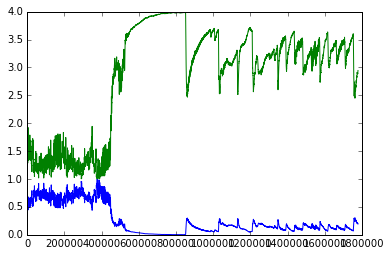

In [16]:
# From Deepak -- take 2

import scipy.signal

def rerange(arr, M=4,
            window=scipy.signal.get_window(('gaussian', 500), 2001)):
    """
    Change dynamic range of input sound array, using a quadratic curve.

    M:
    Silence multiple -- multiply values near silence by this amount.
    Values near maximum sound in arr get multiplied by 1.0
    So choosing M < 1.0 increases dynamic variation in the output.
    
    Quadratic curve is chosen such that turning point is at maximum
    sound. i.e. values near maximum sound do not change much,
    whether M < 1.0 or M > 1.0.

    window:
    kernel for convolution. Default Gaussian with standard deviation
    500 elements centered in a window of 2001 elements.
    """

    window /= np.sum(window) # So weights in window sum to 1.0.
    # Compute weighted sum of window centered at each element.
    means = scipy.signal.fftconvolve(abs(arr), window, 'same')

    # the following handles first half-window and last half-window
    # of means, who get only half the convolution and are therefore
    # artificially small.
    edge_weights = scipy.signal.convolve(np.ones(window.size), window, 'same')
    size2 = int(window.size / 2)
    means[:size2] /= edge_weights[:size2]
    means[-size2:] /= edge_weights[-size2:]

    means /= np.max(means) # Normalize to between 0.0 and 1.0
    
    # The following quadratic curve has value M when means = 0.0,
    # 1.0 when means = 1.0, and has gradient 0 when means = 1.0.
    multipliers = (M - 1) * means**2 + 2 * (1 - M) * means + M

    # Make sure output max loudness doesn't exceed input's.
    maxval = np.abs(arr).max()
    narr = np.clip(arr * multipliers, -maxval, maxval)
    
    return (means, multipliers, np.round(narr))

means, multipliers, narr = rerange(arr)

%matplotlib inline

import matplotlib
import matplotlib.pyplot as plt
plt.plot(means)
plt.plot(multipliers)
plt.show()
